#1. Darknet Clone

> GPU



In [ ]:
# clone repo
!git clone https://github.com/AlexeyAB/darknet

Cloning into 'darknet'...
remote: Enumerating objects: 15097, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (22/22), done.
remote: Total 15097 (delta 8), reused 9 (delta 2), pack-reused 15072
Receiving objects: 100% (15097/15097), 13.49 MiB | 19.67 MiB/s, done.
Resolving deltas: 100% (10253/10253), done.


In [ ]:
%cd darknet

/content/darknet


In [ ]:
# change makefile to have GPU, OPENCV, CUDNN enabled
!sed -i 's/OPENCV=0/OPENCV=1/' Makefile
!sed -i 's/GPU=0/GPU=1/' Makefile
!sed -i 's/CUDNN=0/CUDNN=1/' Makefile

In [ ]:
# compile sources
!make

mkdir -p ./obj/
mkdir -p backup
chmod +x *.sh
g++ -std=c++11 -std=c++11 -Iinclude/ -I3rdparty/stb/include -DOPENCV `pkg-config --cflags opencv4 2> /dev/null || pkg-config --cflags opencv` -DGPU -I/usr/local/cuda/include/ -DCUDNN -Wall -Wfatal-errors -Wno-unused-result -Wno-unknown-pragmas -fPIC -Ofast -DOPENCV -DGPU -DCUDNN -I/usr/local/cudnn/include -c ./src/image_opencv.cpp -o obj/image_opencv.o
./src/image_opencv.cpp: In function ‘void draw_detections_cv_v3(void**, detection*, int, float, char**, image**, int, int)’:
./src/image_opencv.cpp:935:23: warning: variable ‘rgb’ set but not used [-Wunused-but-set-variable]
                 float rgb[3];
                       ^~~
./src/image_opencv.cpp: In function ‘void draw_train_loss(char*, void**, int, float, float, int, int, float, int, char*, float, int, int, double)’:
./src/image_opencv.cpp:1136:13: warning: this ‘if’ clause does not guard... [-Wmisleading-indentation]
             if (iteration_old == 0)
             ^~
./src/image_

In [ ]:
!wget https://pjreddie.com/media/files/yolov3.weights

--2021-06-14 06:36:23--  https://pjreddie.com/media/files/yolov3.weights
Resolving pjreddie.com (pjreddie.com)... 128.208.4.108
Connecting to pjreddie.com (pjreddie.com)|128.208.4.108|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 248007048 (237M) [application/octet-stream]
Saving to: ‘yolov3.weights’

yolov3.weights      100%[===================>] 236.52M  89.7MB/s    in 2.6s    

2021-06-14 06:36:26 (89.7 MB/s) - ‘yolov3.weights’ saved [248007048/248007048]



#2. Tracking

In [ ]:
import cv2
import IPython
import numpy as np
import time
import math
from google.colab.patches import cv2_imshow

In [ ]:
MIN_CONFIDENCE = 0.5
weight_file = 'yolov3.weights'
cfg_file = 'cfg/yolov3.cfg'
name_file = 'data/coco.names'
file_name = 'traffic_video.mp4'

In [ ]:
# load Yolo
net = cv2.dnn.readNet(weight_file, cfg_file)

In [ ]:
classes = []
with open(name_file, 'r') as f:
  classes = [line.strip() for line in f.readlines()]

layer_names = net.getLayerNames()
output_layers = [layer_names[i[0]-1] for i in net.getUnconnectedOutLayers()]

In [ ]:
# upload traffic_sign_video.mp4
from google.colab import files
files.upload()

Saving traffic_video.mp4 to traffic_video.mp4


In [ ]:
def writeFrame(img):
  global writer
  height, width = img.shape[:2]
  if writer is None and output_name is not None:
    fourcc = cv2.VideoWriter_fourcc(*"MJPG")
    writer = cv2.VideoWriter(output_name, fourcc, 24, (width, height), True)
  if writer is not None:
    writer.write(img)

0


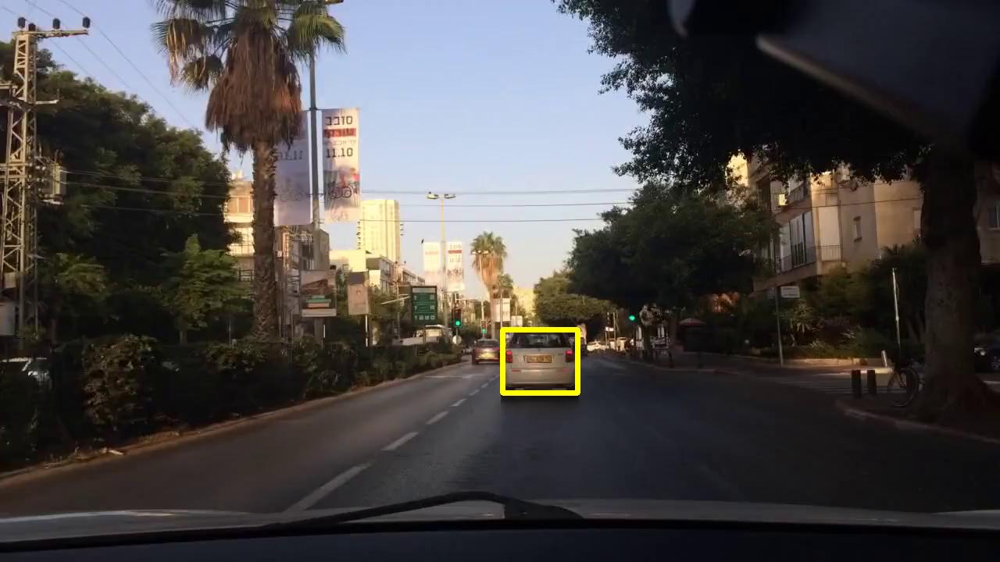

[Detection] Frame 1 time 1.9950225353240967


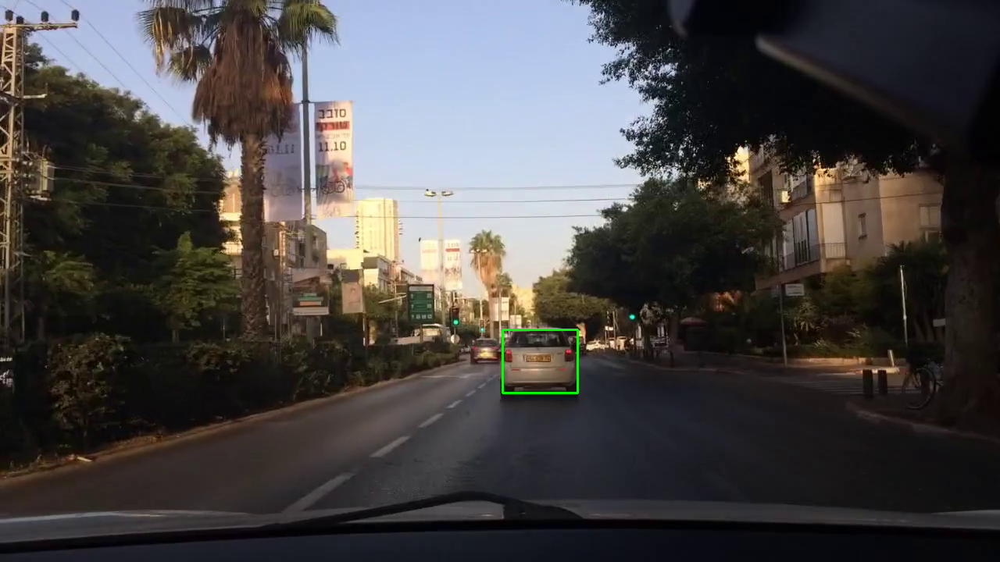

[Tracking] Frame 2 time 0.29773378372192383


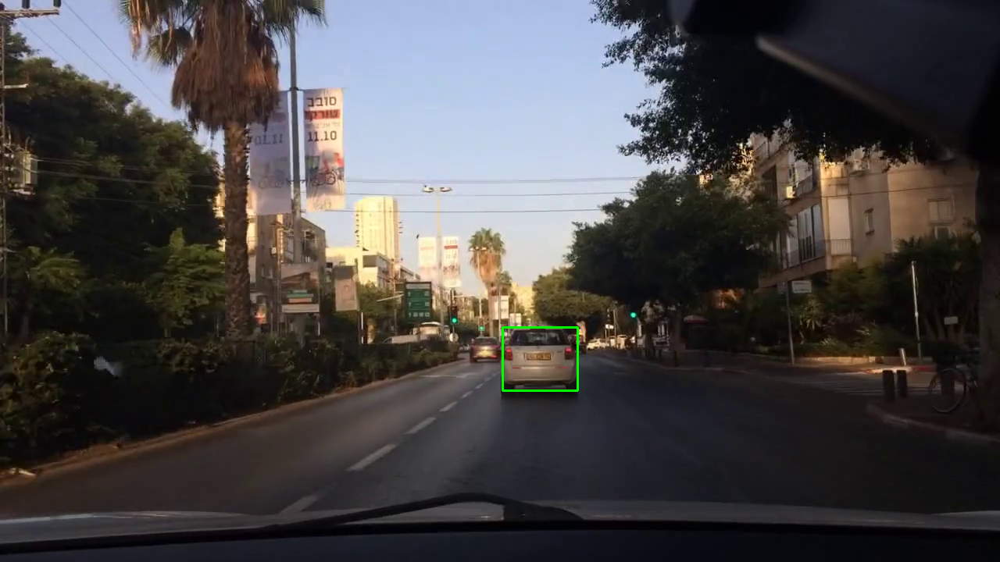

[Tracking] Frame 3 time 0.3029763698577881


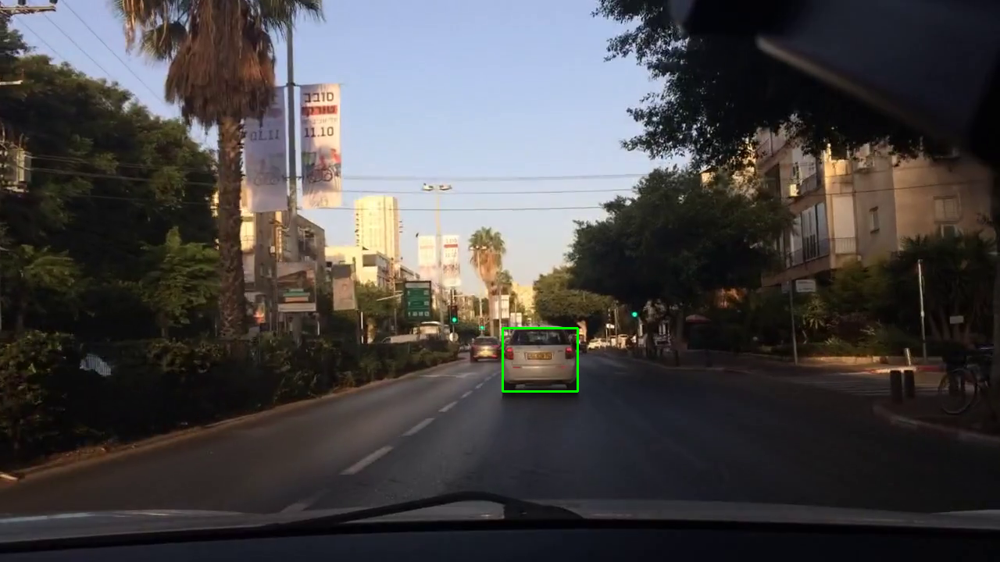

[Tracking] Frame 4 time 0.3098163604736328


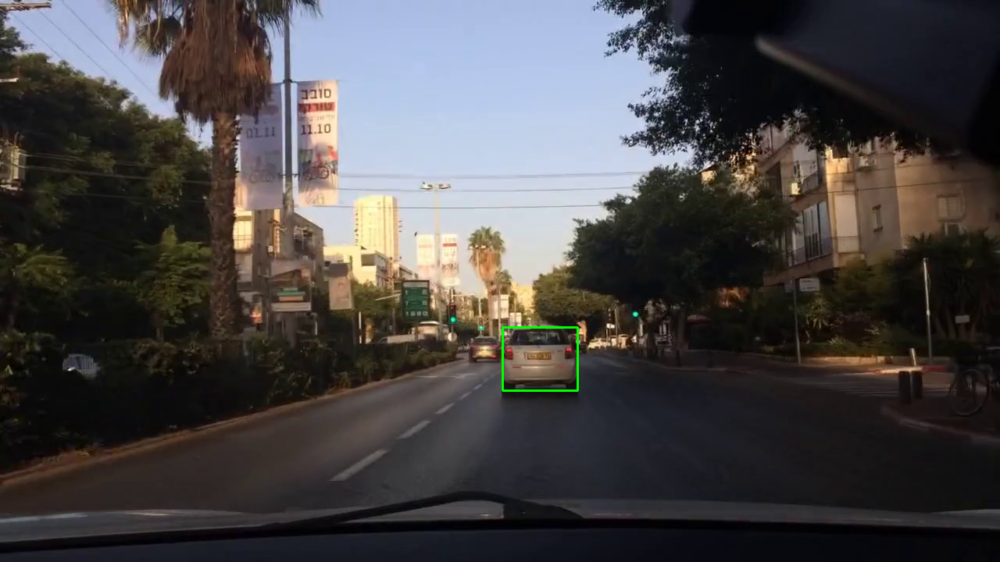

[Tracking] Frame 5 time 0.40145087242126465


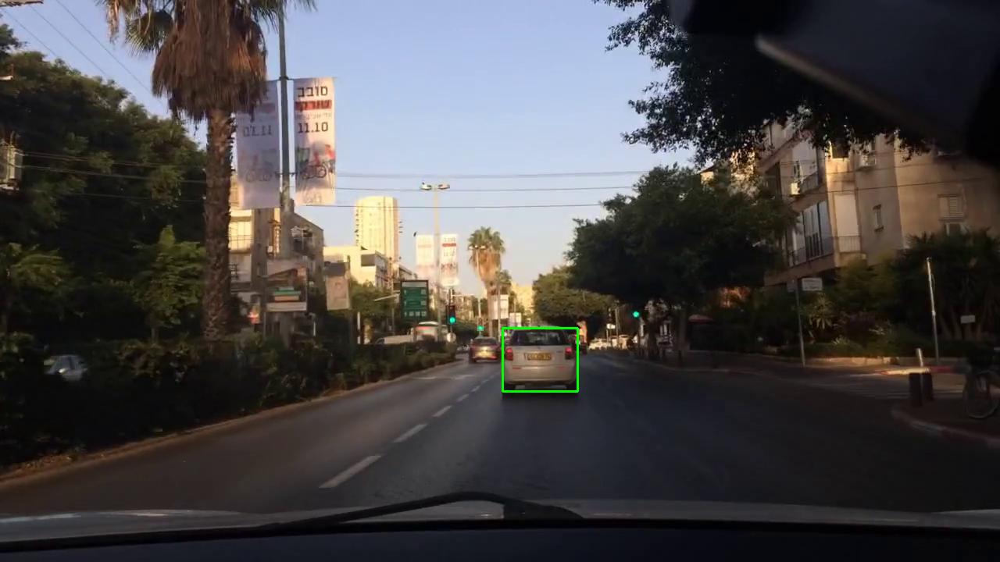

[Tracking] Frame 6 time 0.3348419666290283


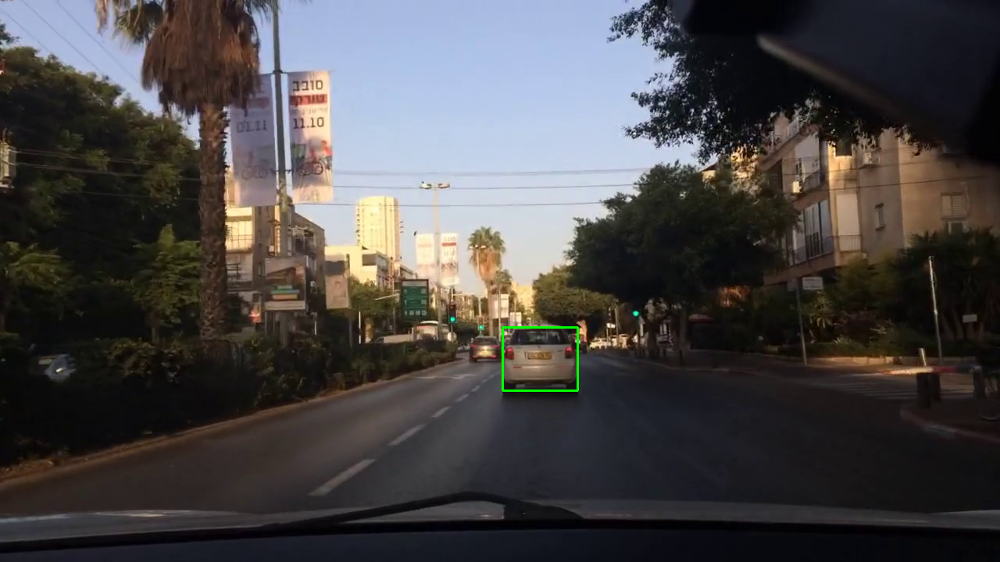

[Tracking] Frame 7 time 0.34795045852661133


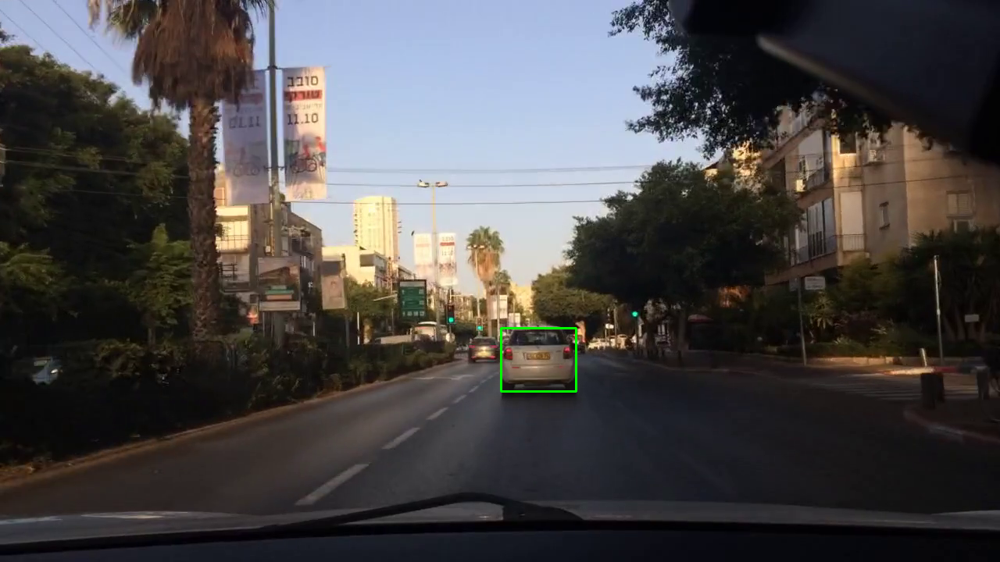

[Tracking] Frame 8 time 0.342754602432251


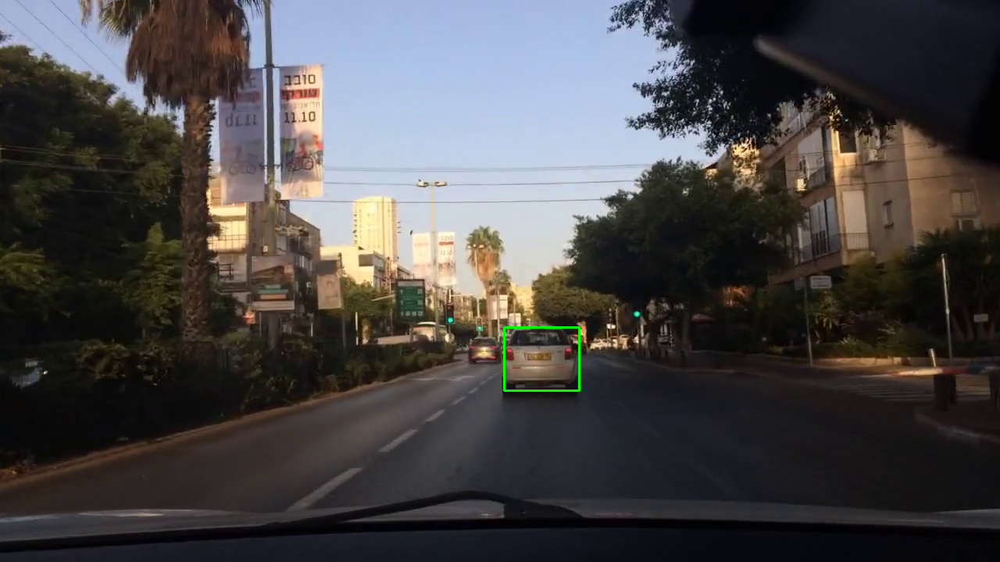

[Tracking] Frame 9 time 0.3518049716949463


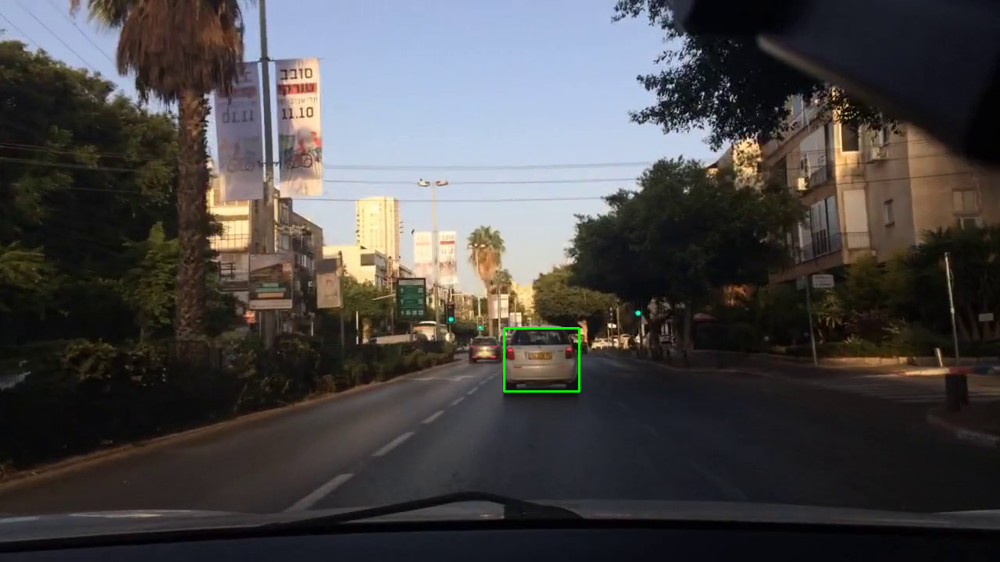

[Tracking] Frame 10 time 0.34644007682800293


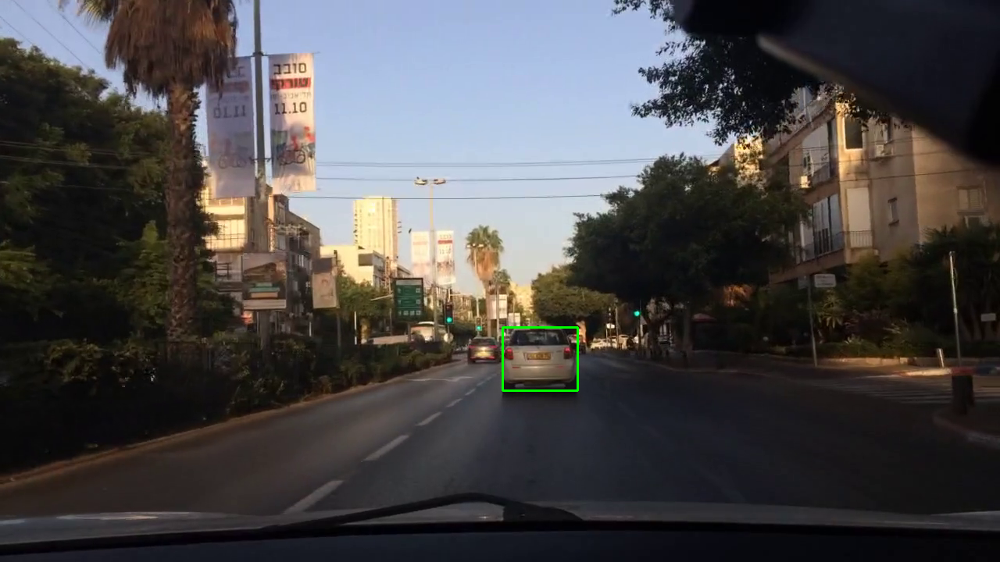

[Tracking] Frame 11 time 0.3944661617279053


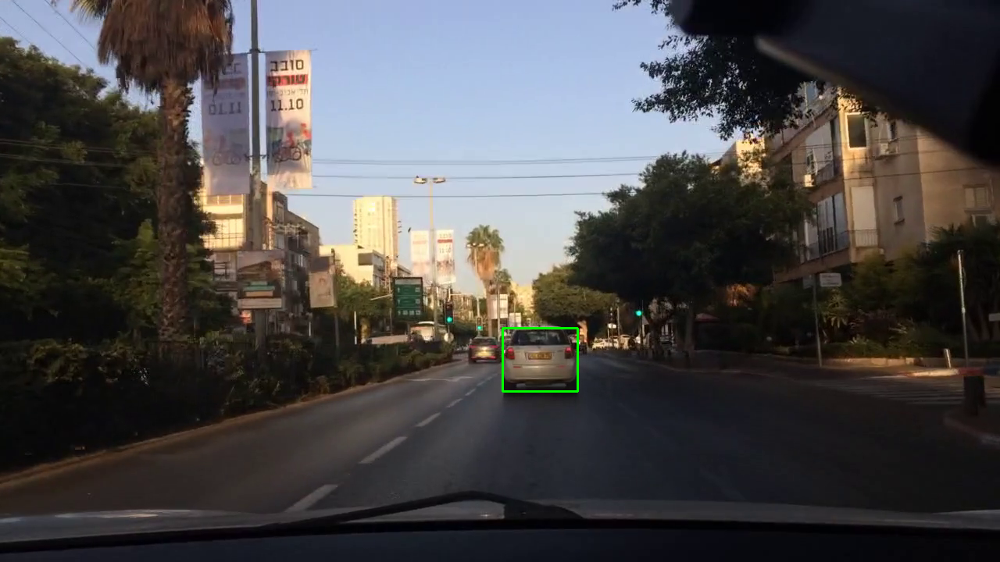

[Tracking] Frame 12 time 0.45895934104919434


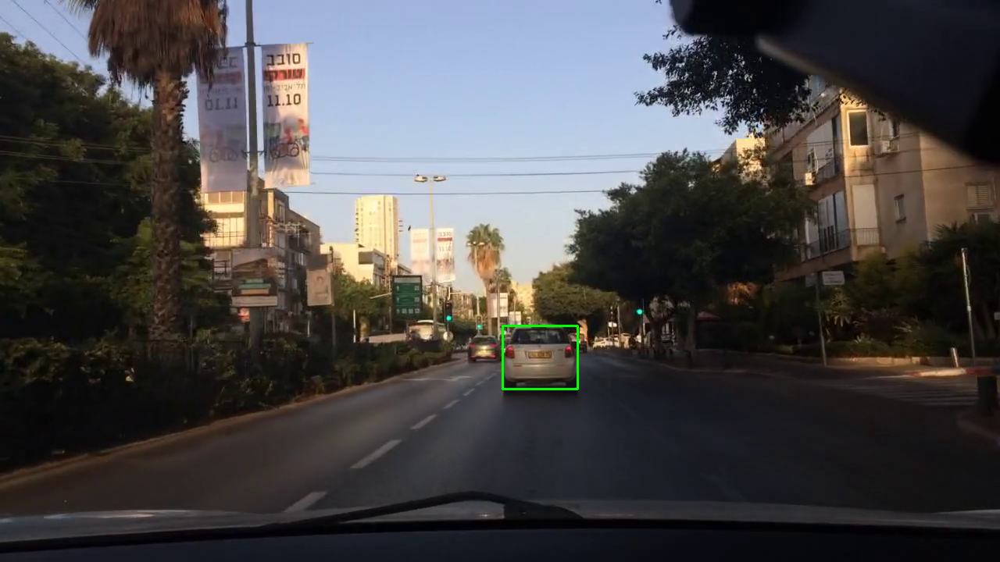

[Tracking] Frame 13 time 0.5736193656921387


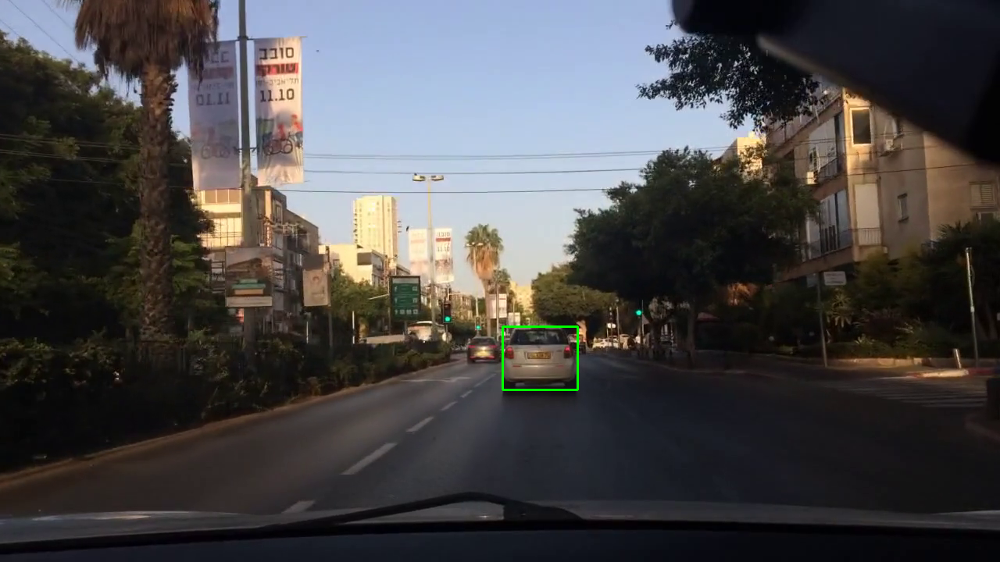

[Tracking] Frame 14 time 0.3561530113220215


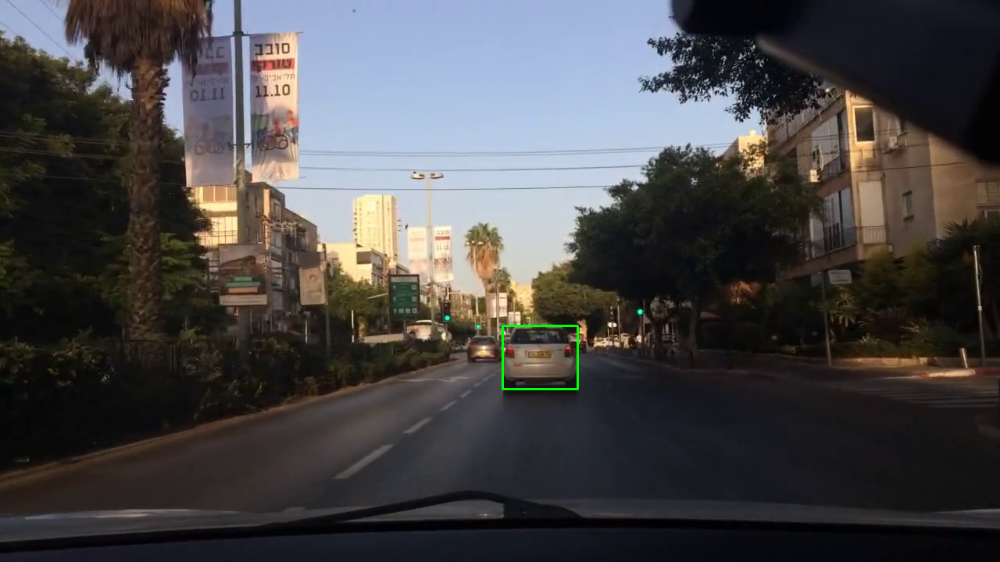

[Tracking] Frame 15 time 0.43822360038757324


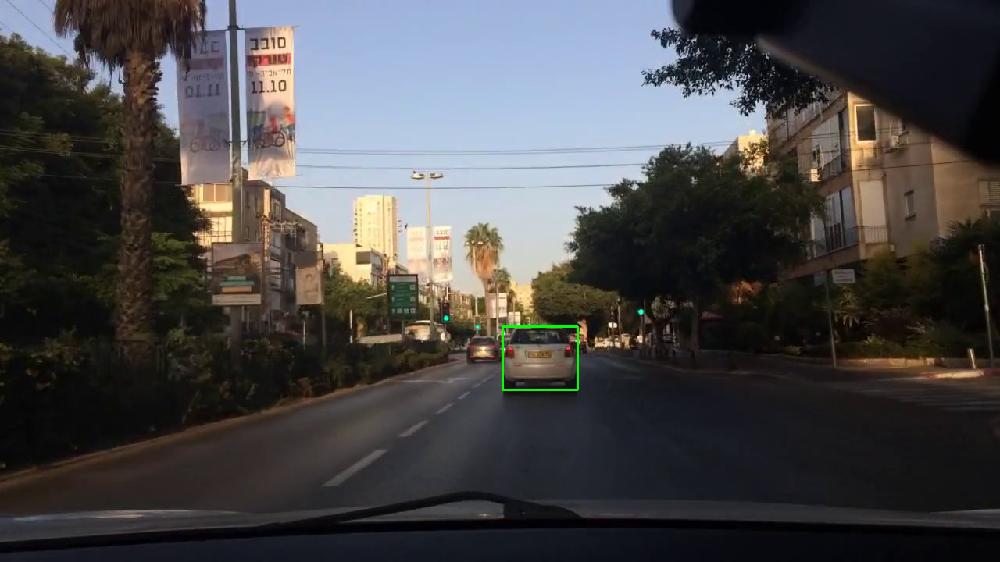

[Tracking] Frame 16 time 0.4159226417541504


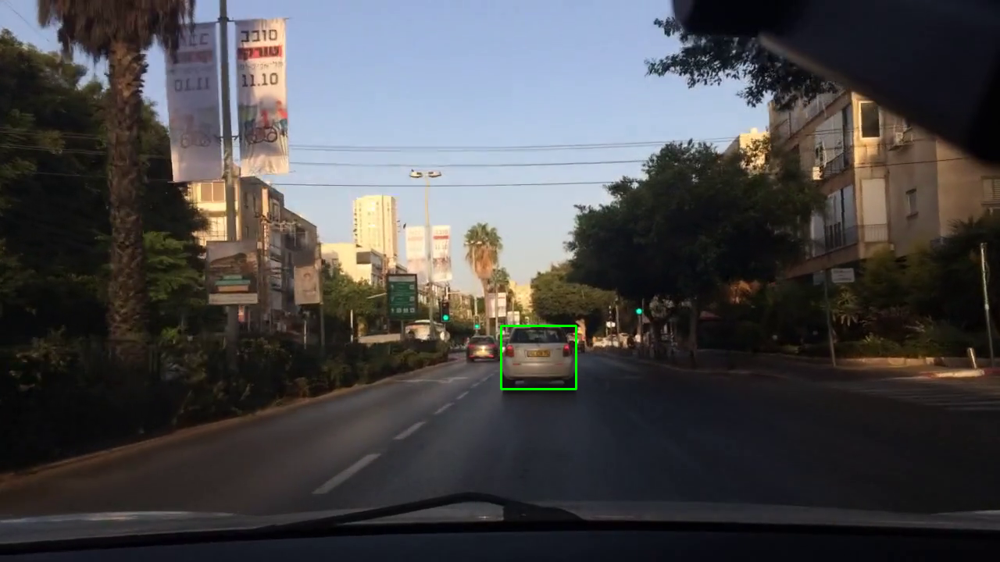

[Tracking] Frame 17 time 0.39755678176879883


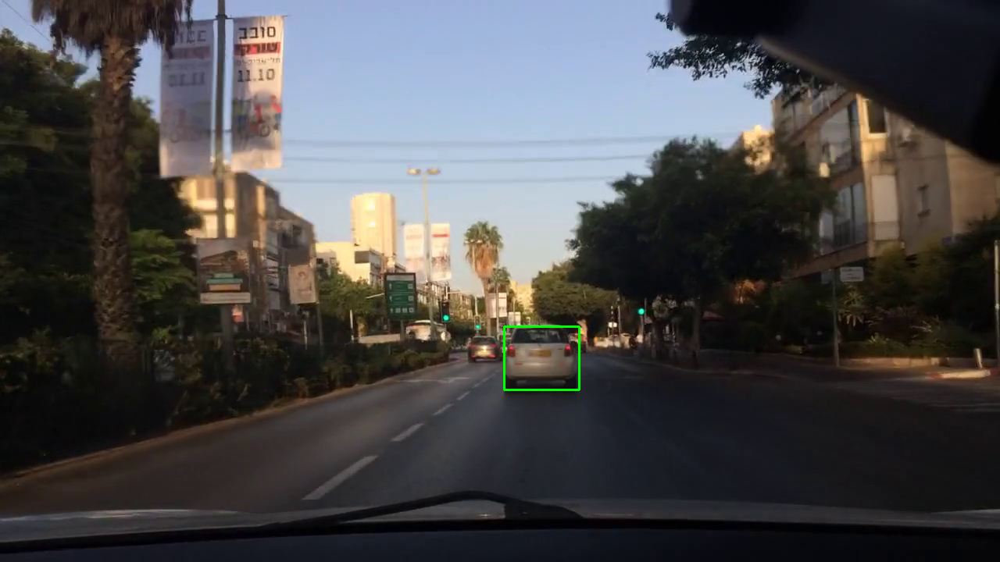

[Tracking] Frame 18 time 0.3907744884490967


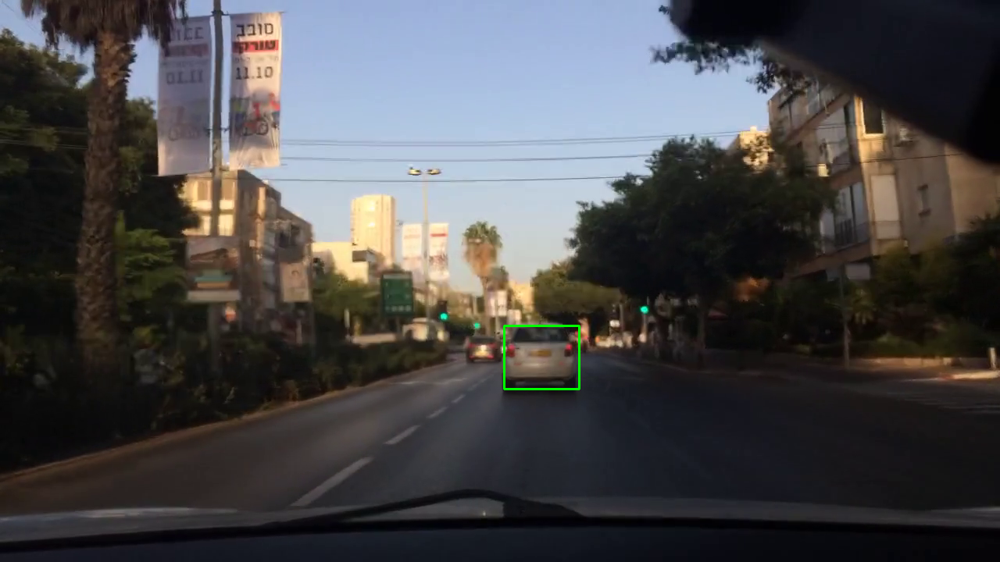

[Tracking] Frame 19 time 0.35822272300720215


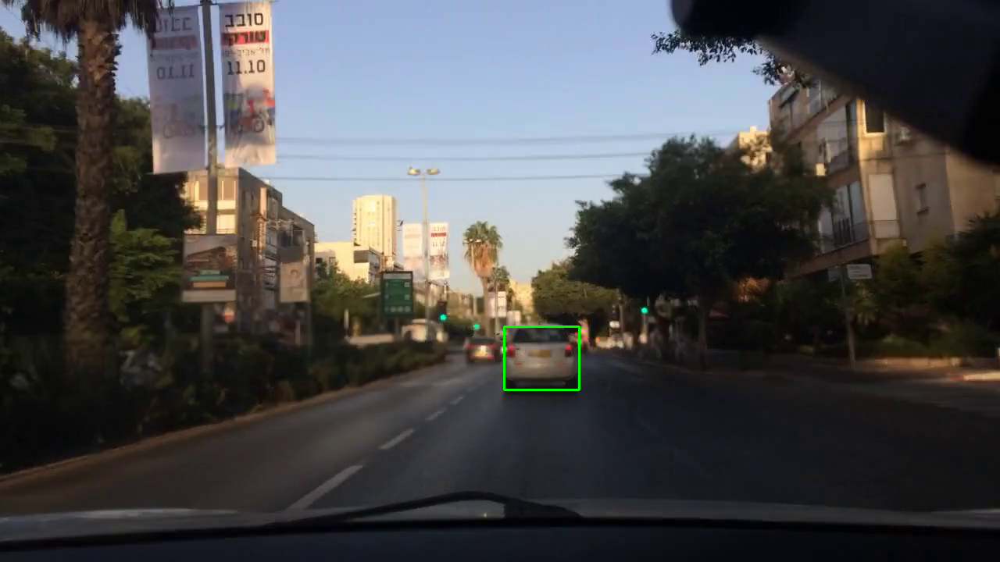

[Tracking] Frame 20 time 0.3415675163269043


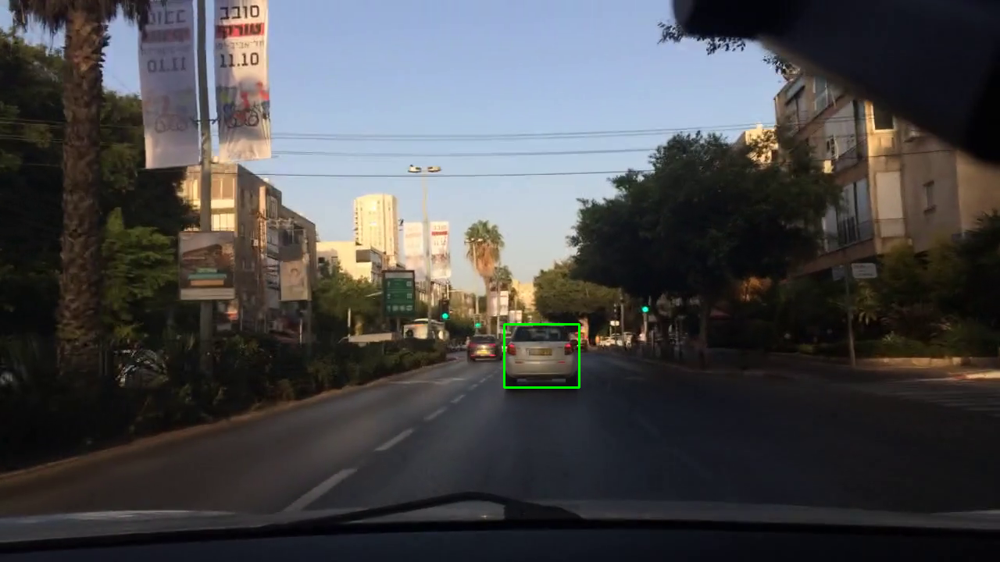

[Tracking] Frame 21 time 0.39429330825805664


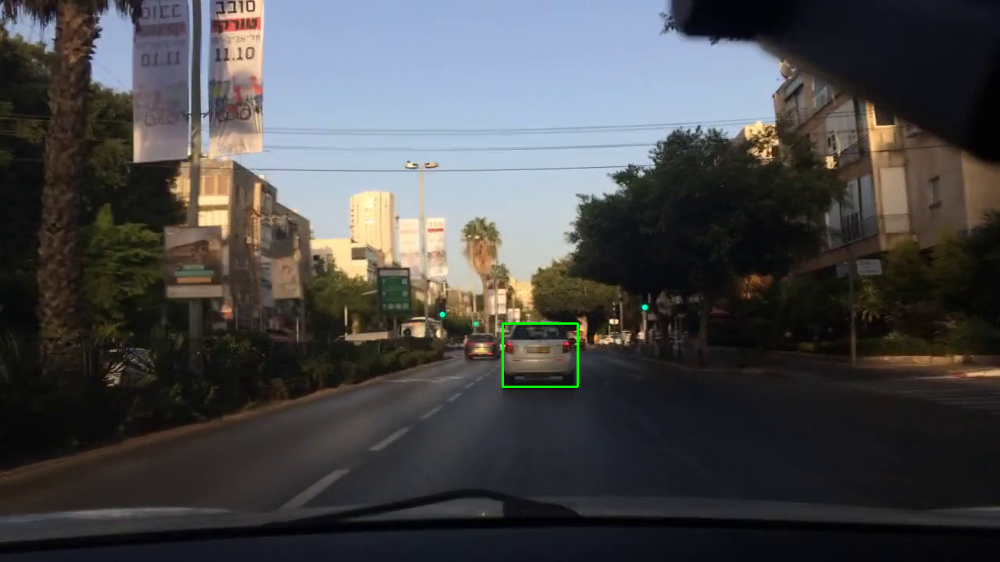

[Tracking] Frame 22 time 0.3896522521972656


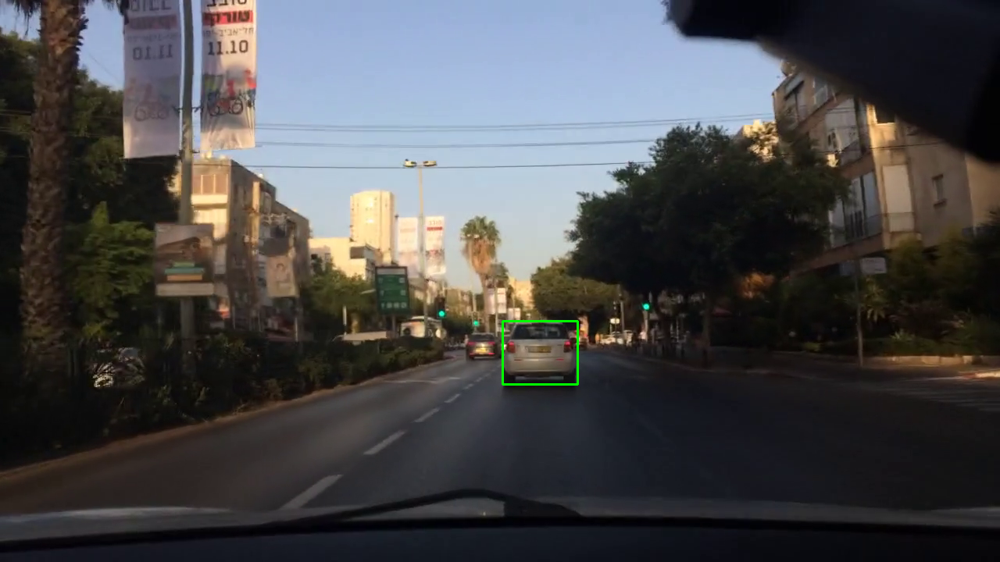

[Tracking] Frame 23 time 0.37741518020629883


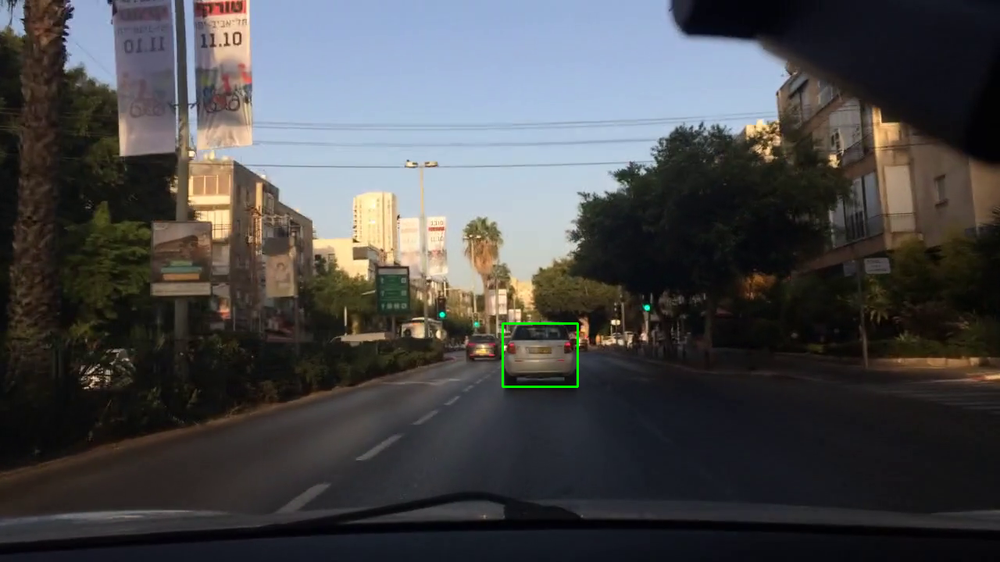

[Tracking] Frame 24 time 0.38153076171875


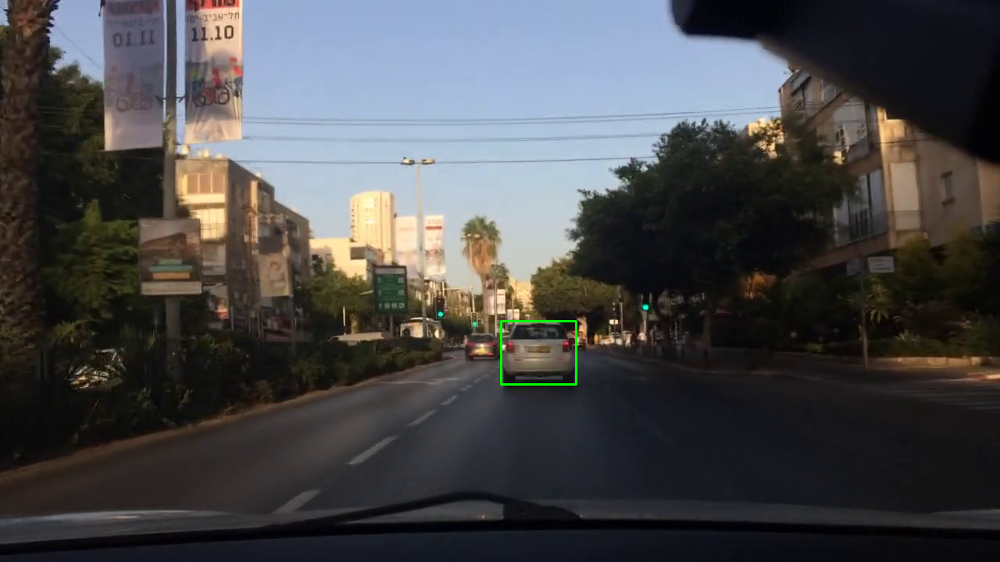

[Tracking] Frame 25 time 0.4095134735107422


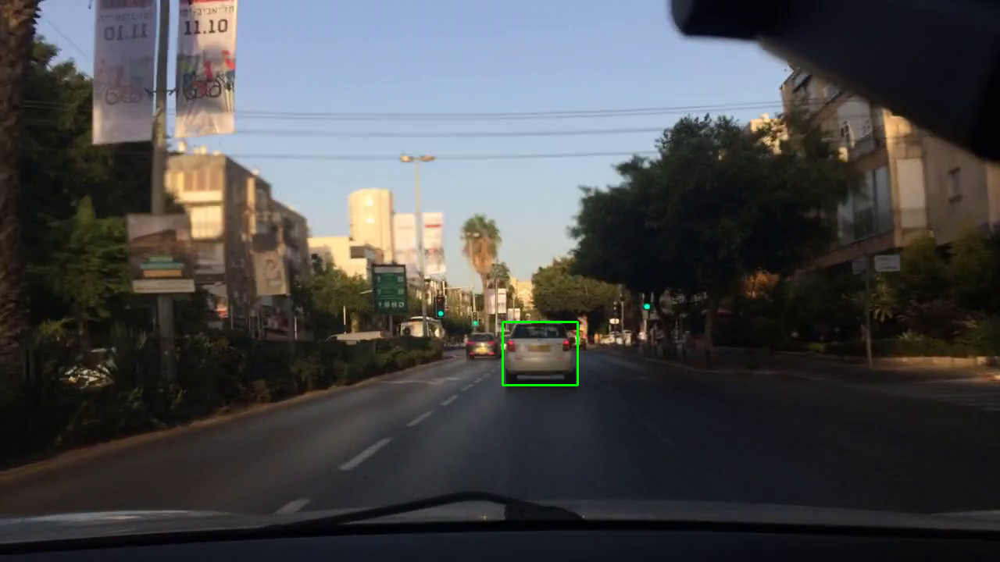

[Tracking] Frame 26 time 0.6489002704620361


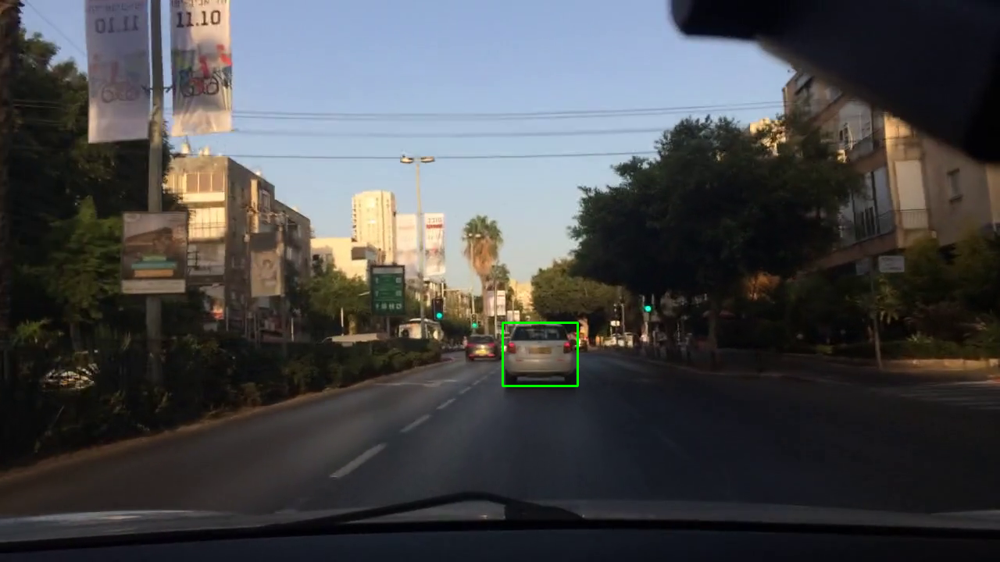

[Tracking] Frame 27 time 0.6571195125579834


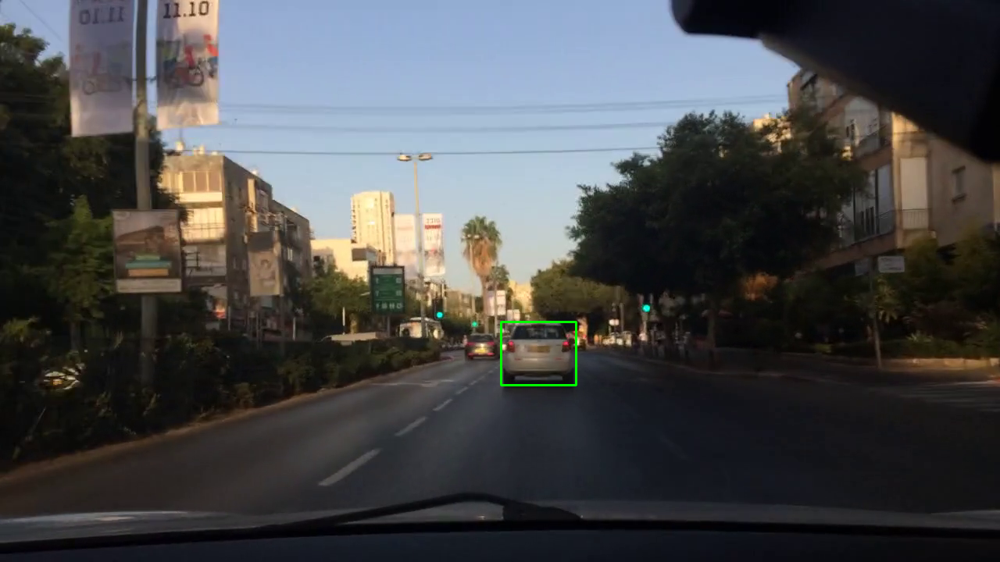

[Tracking] Frame 28 time 0.36939191818237305


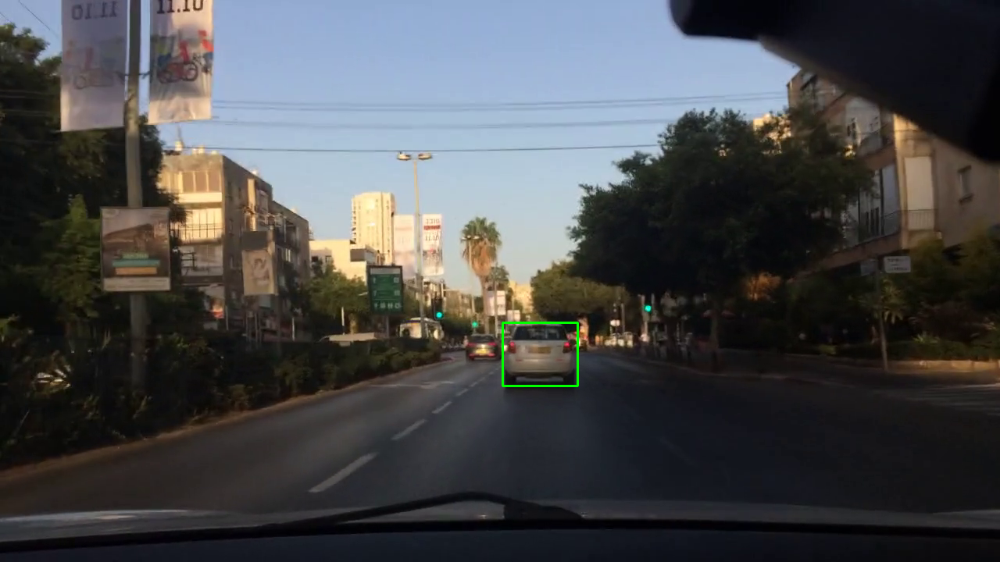

[Tracking] Frame 29 time 0.36490869522094727


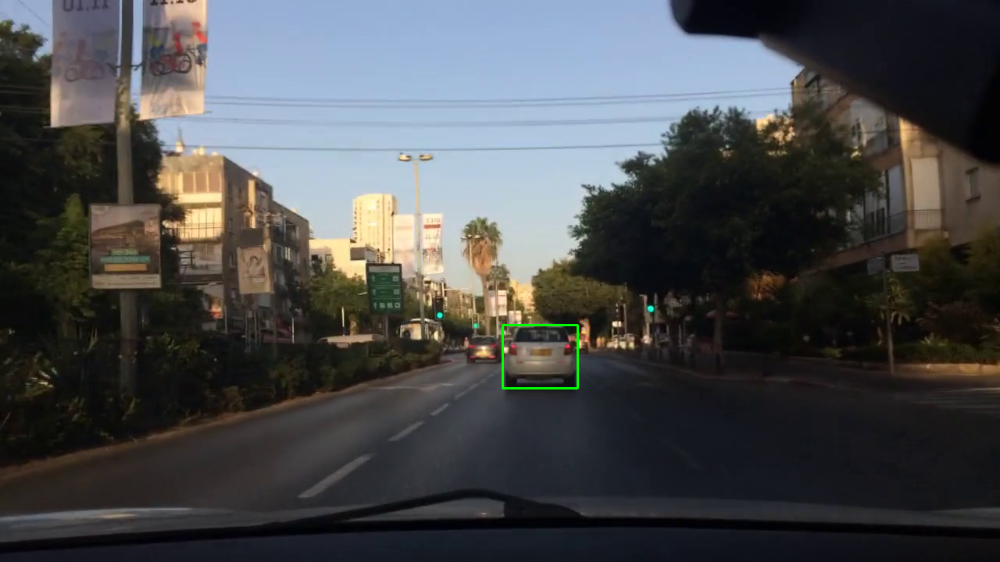

[Tracking] Frame 30 time 0.38747358322143555


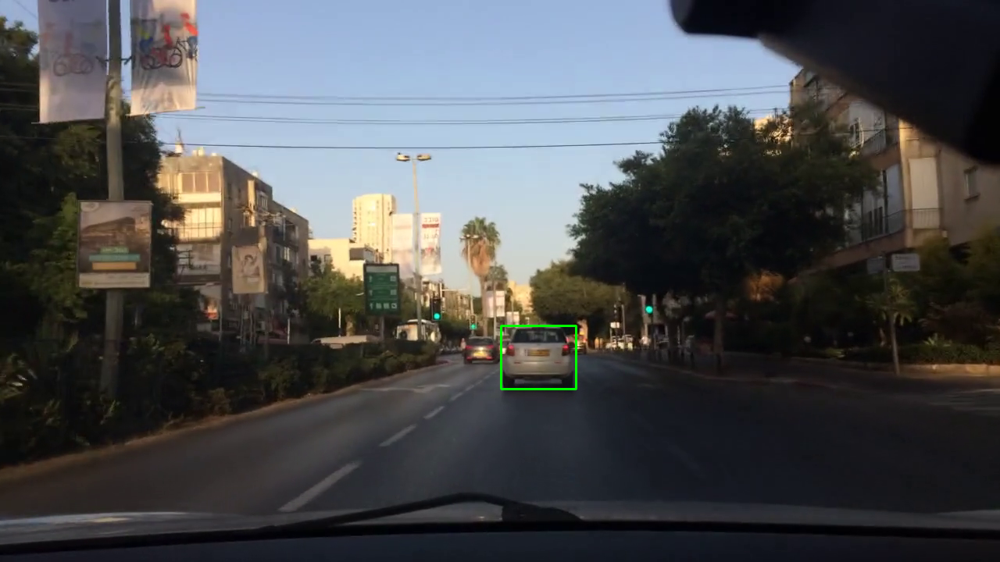

[Tracking] Frame 31 time 0.401580810546875


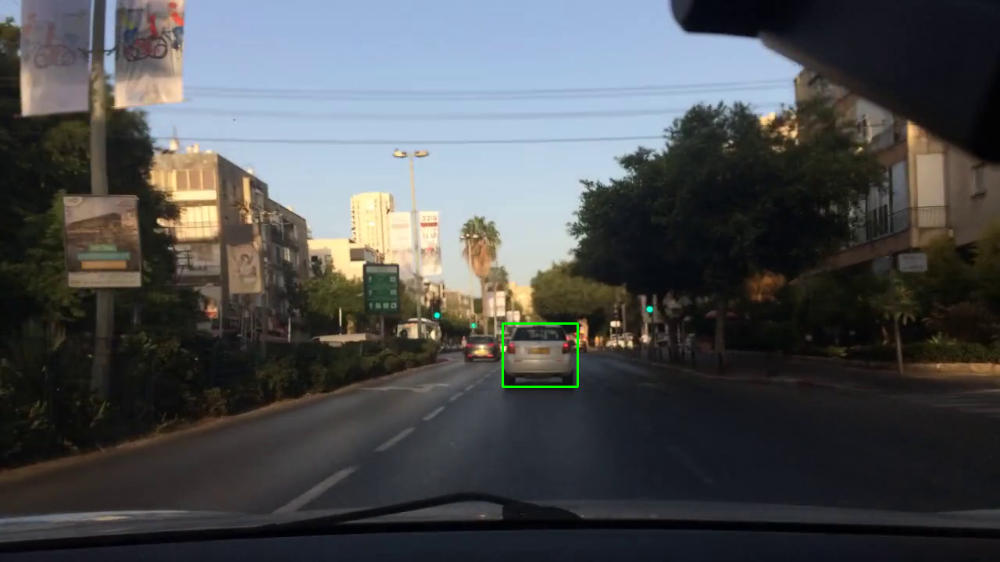

[Tracking] Frame 32 time 0.3642756938934326


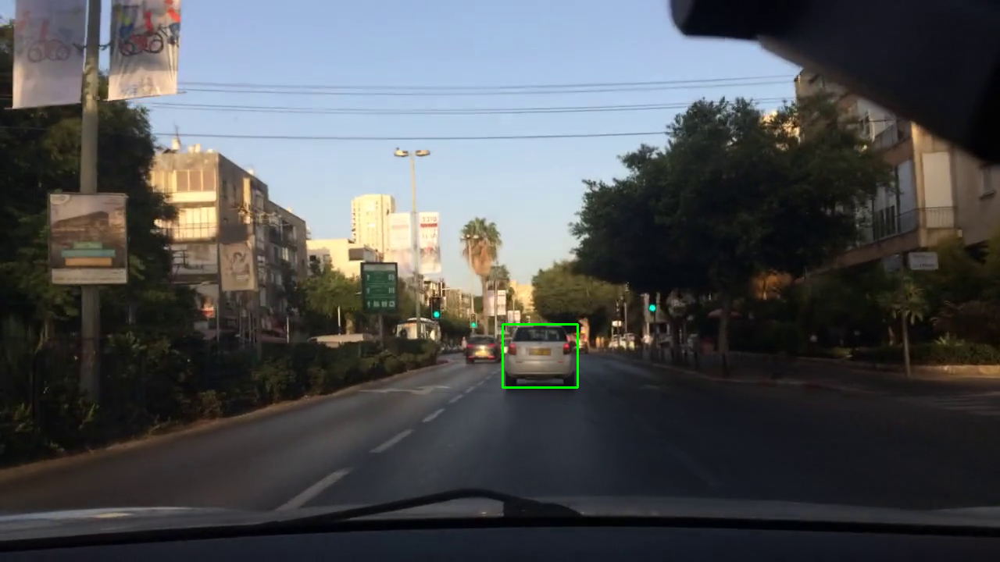

[Tracking] Frame 33 time 0.35982346534729004


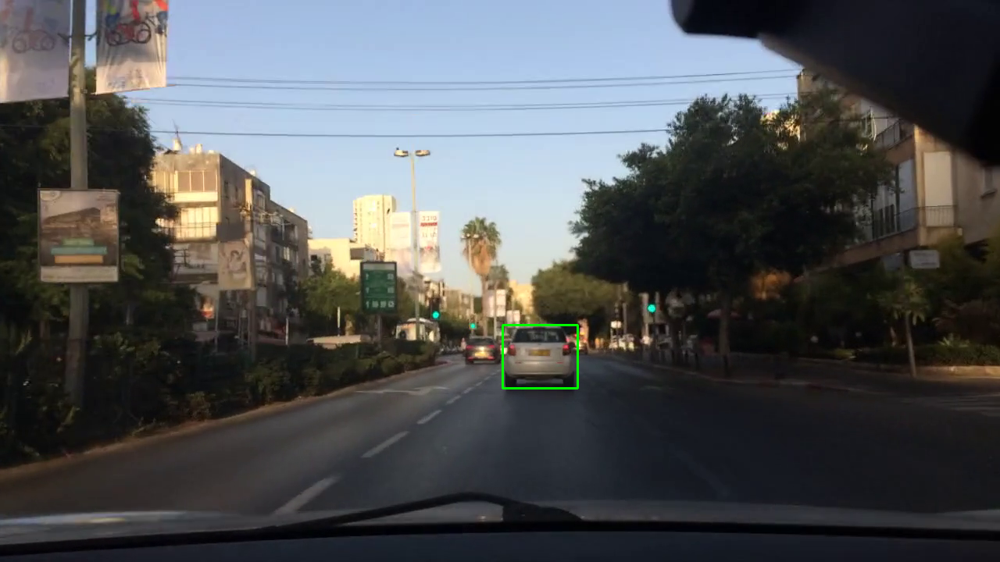

[Tracking] Frame 34 time 0.41674184799194336


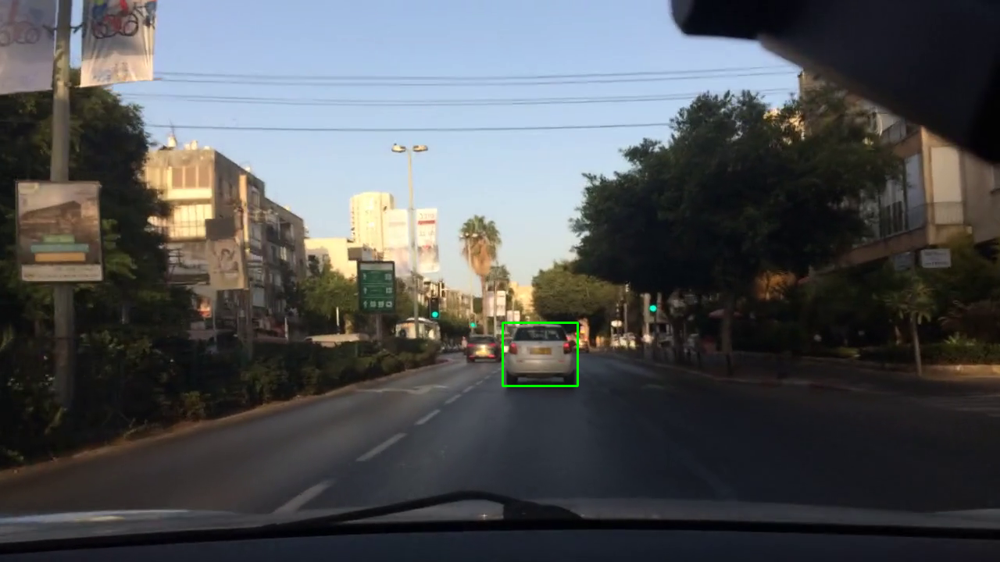

[Tracking] Frame 35 time 0.4019761085510254


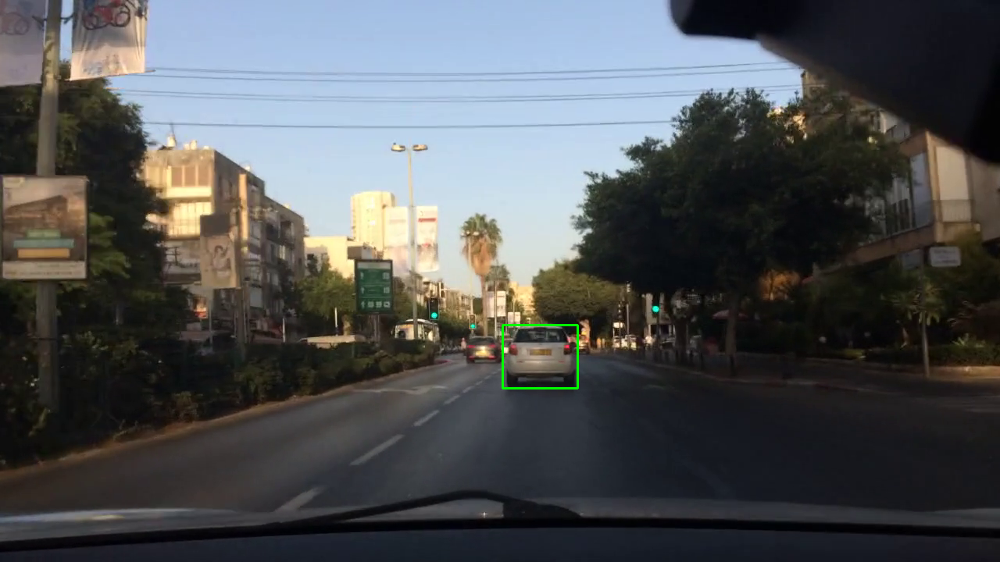

[Tracking] Frame 36 time 0.43882322311401367


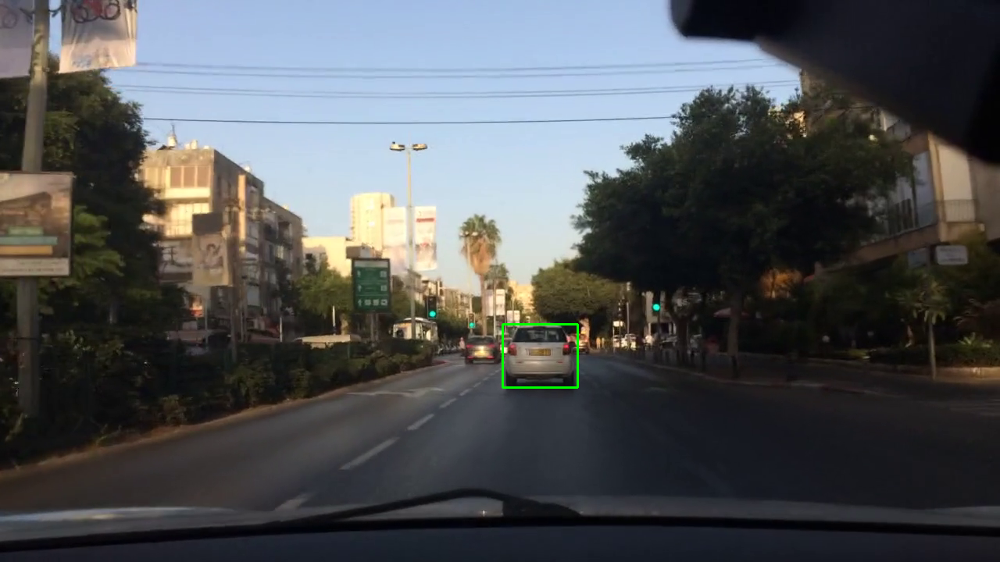

[Tracking] Frame 37 time 0.46233248710632324


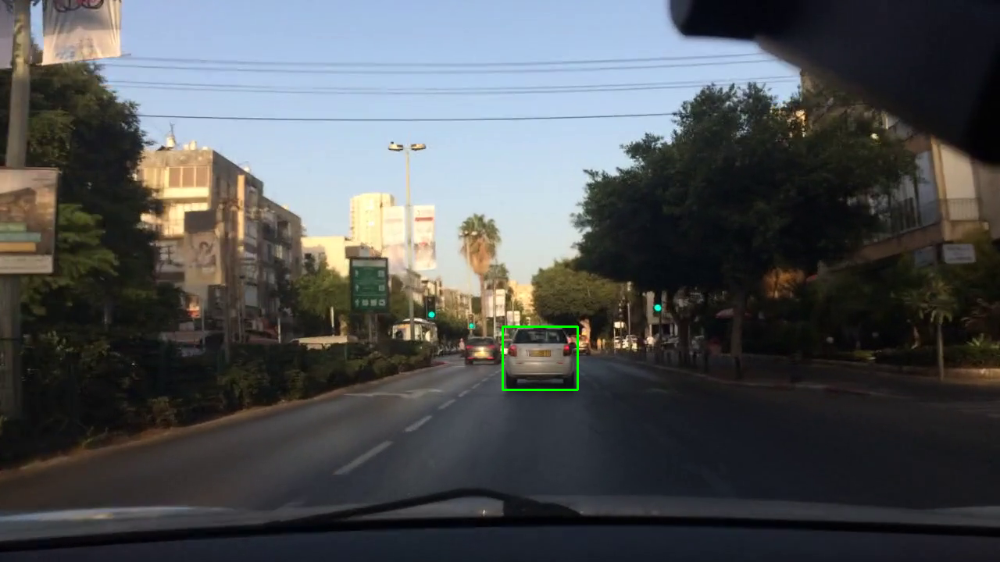

[Tracking] Frame 38 time 0.42361927032470703


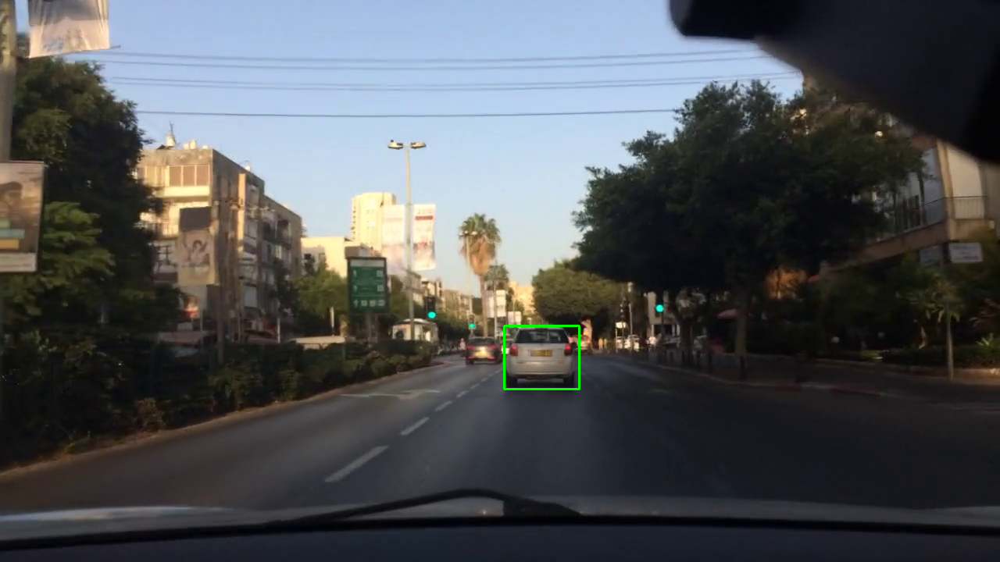

[Tracking] Frame 39 time 0.4184281826019287


KeyboardInterrupt: ignored

In [ ]:
frame_count = 0
writer = None
output_name = 'output_tracking.avi'

detected = False
frame_mode = 'Tracking'
elapsed_time = 0
trackers = cv2.MultiTracker_create()

tracker = cv2.TrackerKCF_create()
# tracker = cv2.TrackerBoosting_create()
# tracker = cv2.TrackerMIL_create()
# tracker = cv2.TrackerTLD_create()
# tracker = cv2.TrackerMedianFlow_create()
# tracker = cv2.TrackerMOSSE_create()

vs = cv2.VideoCapture(file_name)

while True:
  start_time = time.time()
  frame_count += 1
  ret, frame = vs.read()
  if frame is None:
    print("##No more frame##")
    break
  
  if detected:
    frame_mode = 'Tracking'
    (success, boxes) = trackers.update(frame)
    for box in boxes:
      (x, y, w, h) = [int(v) for v in box]
      cv2.rectangle(frame, (x,y), (x+w, y+h), (0,255,0), 2)
  else:
    frame_mode = 'Detection'
    height, width, channedls = frame.shape
    # Detecting objects
    # https://docs.opencv.org/master/d6/d0f/group__dnn.html
    blob = cv2.dnn.blobFromImage(frame, 0.00392, (416, 416), (0, 0, 0), True, crop=False)

    net.setInput(blob)
    outs = net.forward(output_layers)

    class_ids = []
    confidences = []
    boxes = []

    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            # filter only car
            if confidence > MIN_CONFIDENCE and (class_id==2):
                # Object detected
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    # ROI
    mask = np.zeros((height, width), dtype='uint8')
    poly_top = int(0.65 * height)
    poly_bottom = int(0.85 * height)
    poly_left = int(0.47 * width)
    poly_right = int(0.53 * width)
    roi_left = int(0.3 * width)
    roi_right = int(0.6 * width)
    poly_margin = 50
    polygons = np.array([[(0+poly_margin,poly_bottom),(poly_left, poly_top), (poly_right, poly_top), (width-poly_margin, poly_bottom)]])
    cv2.fillPoly(mask, polygons, 255)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, MIN_CONFIDENCE, 0.4)
    font = cv2.FONT_HERSHEY_COMPLEX
    margin = 5
    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]
            # bitwise operation between box and mask
            box = np.array([[(x-margin,y+h+margin),(x-margin,y-margin), (x+w+margin, y), (x+w+margin,y+h+margin)]])
            cv2.fillPoly(mask, box, 0)
            # eliminate small object
            if w>50 and x>roi_left and x<roi_right:
              print(i)
              selected = boxes[i]
              cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 255), 5)
    trackers.add(tracker, frame, tuple(selected))
    detected = True

  cv2_imshow(frame)
  writeFrame(frame)
  frame_time = time.time() - start_time
  elapsed_time += frame_time
  print("[{}] Frame {} time {}".format(frame_mode, frame_count, frame_time))

print("Elapsed time {}".format(elapsed_time))
vs.release()